
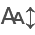

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import textwrap
from io import StringIO
import seaborn as sns
from collections import namedtuple
import missingno as msno
from itables import show
from itables import init_notebook_mode
from scipy.stats import pearsonr
import json
import scipy.stats as stats
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import (
    MaxAbsScaler,
    MinMaxScaler,
    Normalizer,
    PowerTransformer,
    QuantileTransformer,
    RobustScaler,
    StandardScaler,
    minmax_scale,
)
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn import tree, metrics
from sklearn.utils.multiclass import unique_labels
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_multilabel_classification
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import balanced_accuracy_score, accuracy_score, precision_score, recall_score, f1_score
from sklearn.utils.class_weight import compute_sample_weight
import xgboost as xgb

import pydotplus
from IPython.display import Image

# Set the maximum number of rows and columns displayed
pd.set_option('display.max_rows', 250)
pd.set_option('display.max_columns', 250)

# Set options for itables
init_notebook_mode(all_interactive=True)

%matplotlib inline

To view interactive components from github, click this link:

https://nbviewer.org/github/deannachurch/SBCapstone_CRISPRScreens/blob/main/notebooks/ModelingAndEvaluation.ipynb

# To Do (thought of after first submission)

- [ ] change A375 expression to 'expression' for generalization (to try Israel data)
- [ ] run trac1 to test model
- [ ] run Israel to test model

# Overview

This notebook is for evaluating model building to predict gene essentiality. We must apply 2-3 models to this problem, and evaluate the performance of these models. 

The target variable is called 'Annotation' and it has 3 possible values: Essential, Non-essential and Uncharacterized. 

This is a multi-label classification problem, with class imbalance. 

I will test the following classification models:

* Simple Decision Tree
* Random Forest 
* XGBoost

Per the conversation with my mentor, I will use this notebook to code the target variable. 

The use of the decision tree based methods means we don't need to scale data as we did in the Feature Processing notebook.

I will also do a bit of correlation analysis and feature optimization, in addition to hyperparameter tuning and evaluation. 

# Functions

In [2]:
def calculate_ratio(df, num, denom, name):
    """ 
    Calculate the ratio of two columns in a dataframe

    Parameters: 
        df (pd.DataFrame): dataframe on which to operate
        num: column name of the numerator
        denom: column name of the denominator
        name: name of new column

    Returns:
        pd.DataFrame: Updated dataframe with the added ratio column
    """
    # Data validation
    if not isinstance(df, pd.DataFrame):
        raise TypeError("df should be a pandas DataFrame")
    if num not in df.columns:
        raise KeyError(f"{num} not a column name in df")
    if denom not in df.columns:
        raise KeyError(f"{denom} not a column name in df")
    if not pd.api.types.is_numeric_dtype(df[num]):
        raise TypeError(f"num column is not numeric")
    if not pd.api.types.is_numeric_dtype(df[denom]):
        raise TypeError(f"denom column is not numeric")
    
    df[name] = df[num]/df[denom]

    return df

In [3]:
def create_plot_confusion_matrix(y_test, y_pred, title):
    """
    Create a confusion matrix for the gene essentiality classifiers. 

    Parameters:
        y_test: test data (true labels)
        y_pred: predicted data (prediction labels)
        title: plot title

    Returns:
        fig
    """

    # Define the mapping from numerical values to string labels
    label_mapping = {-1: 'Uncategorized', 0: 'NonEssential', 1: 'Essential'}

    # Map the numerical values to string labels
    y_test_mapped = y_test.map(label_mapping)
    y_pred_mapped = pd.Series(y_pred).map(label_mapping)

    # Calculate the confusion matrix
    conf_matrix = metrics.confusion_matrix(y_test_mapped, y_pred_mapped)

    # Get the unique class labels
    class_labels = ['Essential', 'NonEssential', 'Uncategorized']

    # Plot the confusion matrix
    fig = plt.figure(figsize=(10, 7))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title(title)

    return fig

# Preprocessing

- [X] Read in data
- [X] Select only trac2 data (there are two data sets, we can us trac1 as an additional test set)
- [X] Plot some values to see if we can see a separation of values
- [X] Code target variable
- [X] Look at correlation
- [ ] Make test,train splits

In [4]:
# Read in data

full_df=pd.read_csv('../data/processed/brunello_trac2_gene_level_data.csv')
show(full_df)

In [5]:
# will calculate ratios of various attributes. Probably OK to do on full dataframe (before splitting) as this is a per row operation and should not lead to any data leakage.
full_df=calculate_ratio(full_df, 'Tx Length', 'Target Exon_min', 'TargetEx2TxLength')
show(full_df)

In [6]:
# Rename columns
full_df.rename(columns={'A375 mean': 'cell_exp_mean', 'A375 median': 'cell_exp_median', 'A375 std_dev': 'cell_exp_std_dev'}, inplace=True)

# Display the updated dataframe
show(full_df.head())

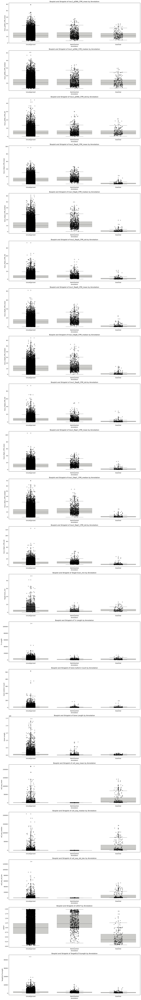

In [7]:
# List of numerical columns excluding 'Target Gene ID'
numerical_columns = full_df.select_dtypes(include=[np.number]).columns.tolist()
numerical_columns.remove('Target Gene ID')

# Set up the figure
fig, axes = plt.subplots(len(numerical_columns), 1, figsize=(15, 5 * len(numerical_columns)))

# Plot each numerical column
for i, col in enumerate(numerical_columns):
    sns.boxplot(x='Annotation', y=col, data=full_df, ax=axes[i], color="#9B9B93", boxprops=dict(alpha=0.5))
    sns.stripplot(x='Annotation', y=col, data=full_df, ax=axes[i], color='black', alpha=0.5, jitter=True)
    axes[i].set_title(f'Boxplot and Stripplot of {col} by Annotation')

plt.tight_layout()
plt.show()

# Observations

There are definitely some features that seem to differentiate Essential from NonEssential genes. it is hard to know about the Uncategorized due to the class imbalance. There are almost certainly some 'essential' genes in this bin. We'll have to see how this impacts model building. 

In [8]:
full_df['Annotation'].value_counts()

Annotation
Uncategorized    18050
NonEssential       858
Essential          207
Name: count, dtype: int64

In [9]:
# Convert 'Annotation' column to numerical values
annotation_mapping = {'Uncategorized': -1, 'NonEssential': 0, 'Essential': 1}
full_df['Annotation'] = full_df['Annotation'].map(annotation_mapping)

# Display the updated dataframe
show(full_df)

In [10]:
#just noticed I need to correct the NaN in TargetEx2TxLenth
full_df['TargetEx2TxLength']=full_df['TargetEx2TxLength'].fillna(0)
full_df.isna().sum()

Target Gene ID           0
trac2_pDNA_CPM_mean      0
trac2_pDNA_CPM_median    0
trac2_pDNA_CPM_std       1
trac2_RepA_CPM_mean      0
trac2_RepA_CPM_median    0
trac2_RepA_CPM_std       1
trac2_RepB_CPM_mean      0
trac2_RepB_CPM_median    0
trac2_RepB_CPM_std       1
trac2_RepC_CPM_mean      0
trac2_RepC_CPM_median    0
trac2_RepC_CPM_std       1
Target Exon_min          0
Tx Length                0
Gene Isoform Count       0
Gene Length              0
cell_exp_mean            0
cell_exp_median          0
cell_exp_std_dev         0
LOEUF                    0
Annotation               0
TargetEx2TxLength        0
dtype: int64

In [11]:
# Print rows with any null values
null_rows = full_df[full_df.isnull().any(axis=1)]
show(null_rows)

In [12]:
#fill remaining null values with 0
full_df = full_df.fillna(0)
full_df.isna().sum()

Target Gene ID           0
trac2_pDNA_CPM_mean      0
trac2_pDNA_CPM_median    0
trac2_pDNA_CPM_std       0
trac2_RepA_CPM_mean      0
trac2_RepA_CPM_median    0
trac2_RepA_CPM_std       0
trac2_RepB_CPM_mean      0
trac2_RepB_CPM_median    0
trac2_RepB_CPM_std       0
trac2_RepC_CPM_mean      0
trac2_RepC_CPM_median    0
trac2_RepC_CPM_std       0
Target Exon_min          0
Tx Length                0
Gene Isoform Count       0
Gene Length              0
cell_exp_mean            0
cell_exp_median          0
cell_exp_std_dev         0
LOEUF                    0
Annotation               0
TargetEx2TxLength        0
dtype: int64

In [13]:
# Make X, y variables
# Not also dropping 'Target Gene ID' as this is just another identifer
X_full = full_df.drop(columns=['Annotation', 'Target Gene ID'])
y_full = full_df['Annotation']
show(X_full.head())
show(y_full.head())

Annotation
Loading ITables v2.1.1 from the init_notebook_mode cell... (need help?)


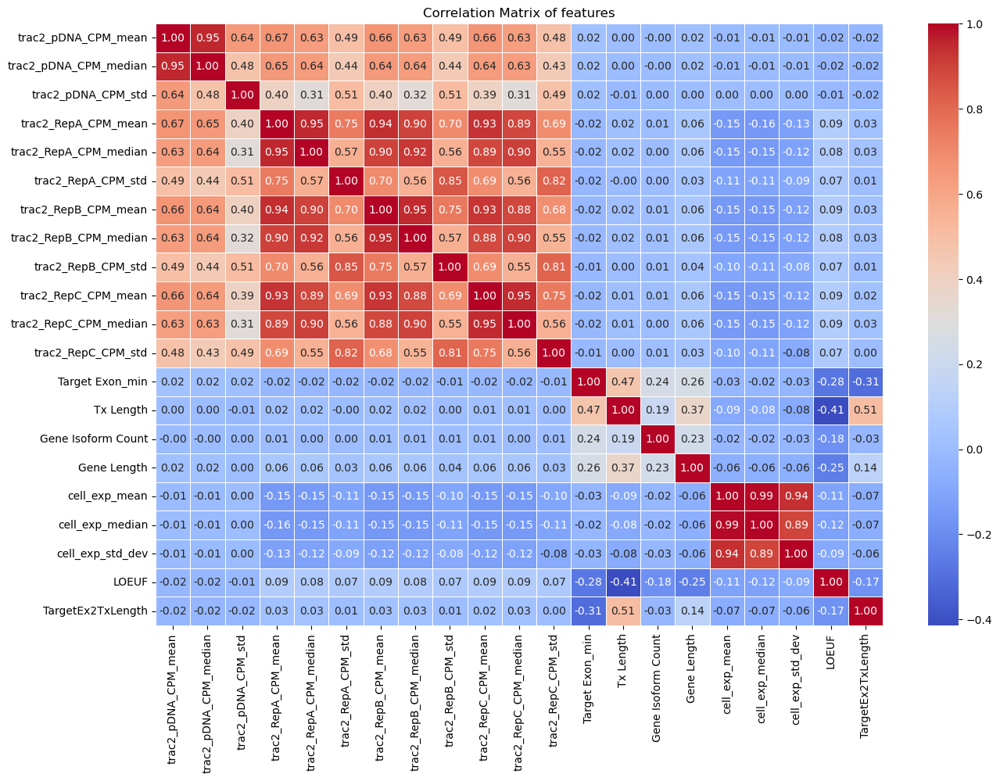

In [14]:
# Calculate the correlation matrix
corr_matrix = X_full.corr()

# Set up the matplotlib figure
plt.figure(figsize=(15, 10))

# Draw the heatmap with the correlation matrix
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', linewidths=0.5)

# Set the title
plt.title('Correlation Matrix of features')

# Show the plot
plt.show()

# Observations

Most of the correlated features are:

* groups of mean, median and std for guide counts and expression
* count replicates (these should be correlated)

In [15]:
# test, train splits
X_train, X_test, y_train, y_test = train_test_split(X_full, y_full, test_size=0.2, random_state=42)

print(f"X train: {X_train.shape}")
print(f"X test: {X_test.shape}")

print(f"Annotation full: {full_df['Annotation'].value_counts()} {full_df['Annotation'].value_counts(normalize=True) * 100}%")
print(f"Annotation split (train): {y_train.value_counts()} {y_train.value_counts(normalize=True) * 100}%")
print(f"Annotation split (test) {y_test.value_counts()} {y_test.value_counts(normalize=True) * 100}%")

X train: (15292, 21)
X test: (3823, 21)
Annotation full: Annotation
-1    18050
 0      858
 1      207
Name: count, dtype: int64 Annotation
-1    94.428459
 0     4.488622
 1     1.082919
Name: proportion, dtype: float64%
Annotation split (train): Annotation
-1    14445
 0      675
 1      172
Name: count, dtype: int64 Annotation
-1    94.461156
 0     4.414073
 1     1.124771
Name: proportion, dtype: float64%
Annotation split (test) Annotation
-1    3605
 0     183
 1      35
Name: count, dtype: int64 Annotation
-1    94.297672
 0     4.786817
 1     0.915511
Name: proportion, dtype: float64%


# Decision tree

First, let's just build a basic decision tree to see how it does.

- [X] build non-optimized entropy model 
- [X] build non-optimized gini impurity model
- [X] print trees
- [X] print evaluation metrics

In [16]:
# entropy model
entr_nonopt_model=tree.DecisionTreeClassifier(criterion='entropy', random_state=1338)
#fit model
entr_nonopt_model.fit(X_train, y_train)
#predict
entr_nonopt_y_pred = entr_nonopt_model.predict(X_test)
#turn into a series
entr_nonopt_y_pred = pd.Series(entr_nonopt_y_pred)

In [17]:
# Visualize Tree
dot_data = StringIO()

tree.export_graphviz(entr_nonopt_model, out_file=dot_data,
                     filled=True, rounded=True,
                     special_characters=True, feature_names=X_train.columns, class_names=['Uncharacterized', 'NonEssential', 'Essential'])
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.791894 to fit



# Observation

That is one complicated tree! Definitely need simplification!

Model Entropy - no max depth
Accuracy: 0.9165576772168454
Balanced accuracy: 0.5005151214286977


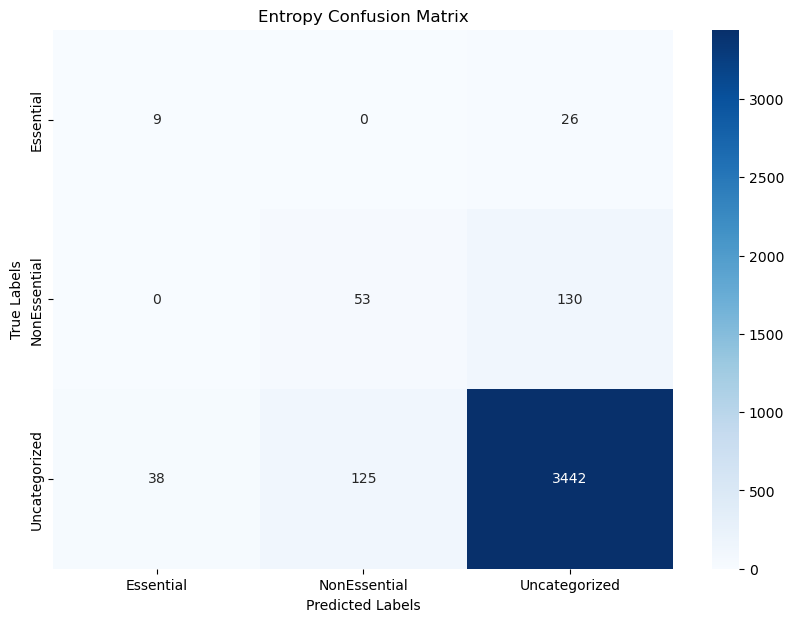

In [18]:
# Run this block for model evaluation metrics 
print("Model Entropy - no max depth")
print("Accuracy:", metrics.accuracy_score(y_test, entr_nonopt_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test, entr_nonopt_y_pred))

fig = create_plot_confusion_matrix(y_test, entr_nonopt_y_pred, 'Entropy Confusion Matrix')
plt.show()

In [19]:
ent_feature_importances=entr_nonopt_model.feature_importances_

# Create a DataFrame to display the feature importances
feature_importances_df = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': ent_feature_importances
}).sort_values(by='Importance', ascending=False)

# Display the feature importances
print(feature_importances_df)


                  Feature  Importance
17        cell_exp_median    0.258781
4   trac2_RepA_CPM_median    0.117938
16          cell_exp_mean    0.062712
19                  LOEUF    0.046231
20      TargetEx2TxLength    0.044449
13              Tx Length    0.039738
5      trac2_RepA_CPM_std    0.036815
15            Gene Length    0.035160
3     trac2_RepA_CPM_mean    0.034257
10  trac2_RepC_CPM_median    0.033928
2      trac2_pDNA_CPM_std    0.032781
8      trac2_RepB_CPM_std    0.030163
11     trac2_RepC_CPM_std    0.029767
1   trac2_pDNA_CPM_median    0.029603
9     trac2_RepC_CPM_mean    0.028659
14     Gene Isoform Count    0.027770
6     trac2_RepB_CPM_mean    0.027553
18       cell_exp_std_dev    0.026737
0     trac2_pDNA_CPM_mean    0.024977
7   trac2_RepB_CPM_median    0.020768
12        Target Exon_min    0.011214


Interesting that RepA median is weighted above other counts. Expression seems to be the biggest factor. I expected LOEUF to be higher, but still in the top 4. 

# Observation

Accuracy is high because most Uncategorized genes get categorized correctly, but we are not doing a very good job on predicting gene essentiality- in fact, most of these are classified as 'Uncategorized'. 

In [20]:
# gini model
gini_nonopt_model=tree.DecisionTreeClassifier(criterion='gini', random_state=1338)
#fit model
gini_nonopt_model.fit(X_train, y_train)
#predict
gini_nonopt_y_pred = gini_nonopt_model.predict(X_test)
#turn into a series
gini_nonopt_y_pred = pd.Series(gini_nonopt_y_pred)

In [21]:
# Visualize Tree
dot_data = StringIO()

tree.export_graphviz(gini_nonopt_model, out_file=dot_data,
                     filled=True, rounded=True,
                     special_characters=True, feature_names=X_train.columns, class_names=['Uncharacterized', 'NonEssential', 'Essential'])
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.784951 to fit



# Observation

Also- very complicated!

Model Gini - no max depth
Accuracy: 0.909495160868428
Balanced accuracy: 0.45935037604622203


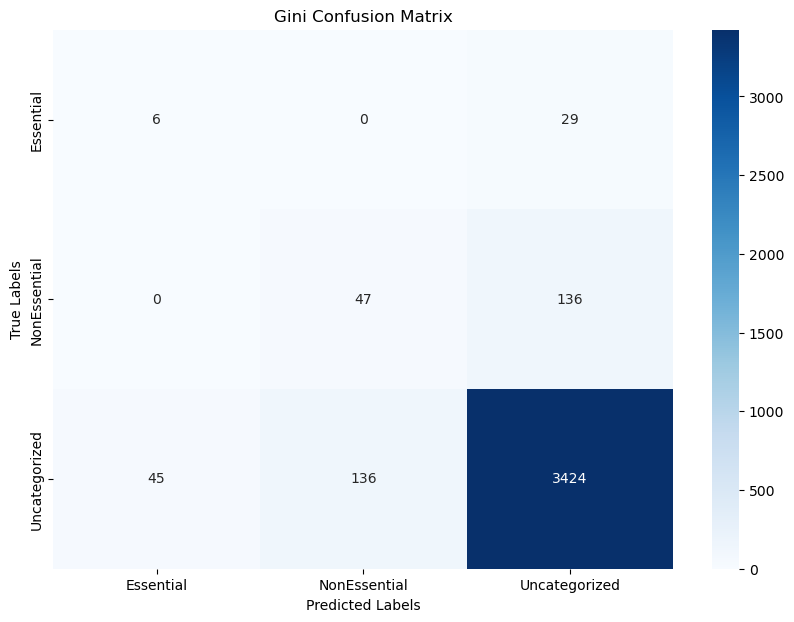

In [22]:
# Run this block for model evaluation metrics 
print("Model Gini - no max depth")
print("Accuracy:", metrics.accuracy_score(y_test, gini_nonopt_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test, gini_nonopt_y_pred))

fig = create_plot_confusion_matrix(y_test, gini_nonopt_y_pred, 'Gini Confusion Matrix')
plt.show()

In [23]:
gini_feature_importances=gini_nonopt_model.feature_importances_

# Create a DataFrame to display the feature importances
feature_importances_df = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': gini_feature_importances
}).sort_values(by='Importance', ascending=False)

# Display the feature importances
print(feature_importances_df)

                  Feature  Importance
16          cell_exp_mean    0.163164
19                  LOEUF    0.086555
20      TargetEx2TxLength    0.051354
8      trac2_RepB_CPM_std    0.049966
7   trac2_RepB_CPM_median    0.045906
2      trac2_pDNA_CPM_std    0.045849
15            Gene Length    0.045466
13              Tx Length    0.045368
17        cell_exp_median    0.043682
11     trac2_RepC_CPM_std    0.042800
10  trac2_RepC_CPM_median    0.042446
9     trac2_RepC_CPM_mean    0.041913
6     trac2_RepB_CPM_mean    0.041550
18       cell_exp_std_dev    0.041151
4   trac2_RepA_CPM_median    0.041007
5      trac2_RepA_CPM_std    0.035651
3     trac2_RepA_CPM_mean    0.033651
1   trac2_pDNA_CPM_median    0.031839
0     trac2_pDNA_CPM_mean    0.030678
14     Gene Isoform Count    0.023855
12        Target Exon_min    0.016147


Interesting to see the shift in feature importances. 

# Observation

Did slightly worse- called two more genes Essential. Both models performed more poorly after removing Target Gene ID! (this is odd- this is just a random identifier.)

# Conclusion

This base model performs poorly. Likely:

* too many correlated features
* too many genes in the Uncharacterized category that may be essential or nonessential.

Next step:

Focus on RandomForest and XGBoost models. 

# Random Forest

* Based on decision trees, less reduce redundant features. 
    + For the counts, just take RepA
    + one dataframe with means, one with median, then one with std
    + test all on unoptimized
* Pick beset feature sets
    + do hyperparameter tuning
    + 5-fold cross-validation

In [24]:
# Drop columns starting with 'trac2_pDNA', 'trac2_RepB', and 'trac2_RepC'
columns_to_drop = X_train.filter(regex='^(trac2_pDNA|trac2_RepB|trac2_RepC)').columns

X_train_sub = X_train.drop(columns=columns_to_drop)
X_test_sub = X_test.drop(columns=columns_to_drop)

# Display the updated dataframes
show(X_train.head())
show(X_test.head())

In [26]:
# now make three dataframes - mean, median and std
non_mean_cols=['trac2_RepA_CPM_median', 'trac2_RepA_CPM_std', 'cell_exp_median', 'cell_exp_std_dev']
non_med_cols=['trac2_RepA_CPM_mean', 'trac2_RepA_CPM_std', 'cell_exp_mean', 'cell_exp_std_dev']
non_std_cols=['trac2_RepA_CPM_mean', 'trac2_RepA_CPM_median', 'cell_exp_mean', 'cell_exp_median']
X_train_mean=X_train_sub.drop(columns=non_mean_cols)
X_test_mean=X_test_sub.drop(columns=non_mean_cols)
X_train_med=X_train_sub.drop(columns=non_med_cols)
X_test_med=X_test_sub.drop(columns=non_med_cols)
X_train_std=X_train_sub.drop(columns=non_std_cols)
X_test_std=X_test_sub.drop(columns=non_std_cols)
show(X_train_mean.head())
show(X_train_med.head())
show(X_train_std.head())
print(X_train_mean.shape)
print(X_test_mean.shape)
print(X_train_med.shape)
print(X_test_med.shape)
print(X_train_std.shape)
print(X_test_std.shape)
print(y_train.shape)
print(y_test.shape)

(15292, 8)
(3823, 8)
(15292, 8)
(3823, 8)
(15292, 8)
(3823, 8)
(15292,)
(3823,)


In [27]:
#Try simple models first, then try hyper parameter tuning
# Create a named tuple to map dataframes to names
DataFrameSet = namedtuple('DataFrameSet', ['mean', 'median', 'std'])

# Instantiate the named tuple with the three dataframes
train_sets = DataFrameSet(mean=X_train_mean, median=X_train_med, std=X_train_std)
test_sets = DataFrameSet(mean=X_test_mean, median=X_test_med, std=X_test_std)

Testing mean


Results for mean set:
Accuracy: 0.9453308919696574
F1 Score: 0.9278818186940206
              precision    recall  f1-score   support

          -1       0.95      1.00      0.97      3605
           0       0.54      0.10      0.17       183
           1       0.80      0.23      0.36        35

    accuracy                           0.95      3823
   macro avg       0.76      0.44      0.50      3823
weighted avg       0.93      0.95      0.93      3823



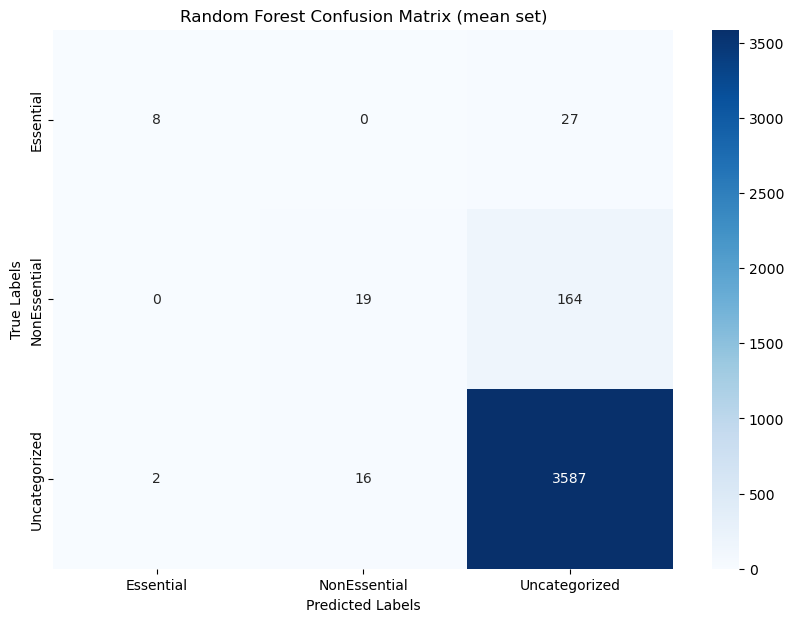

Testing median


Results for median set:
Accuracy: 0.9442845932513733
F1 Score: 0.9251920417992472
              precision    recall  f1-score   support

          -1       0.95      1.00      0.97      3605
           0       0.52      0.09      0.15       183
           1       0.83      0.14      0.24        35

    accuracy                           0.94      3823
   macro avg       0.77      0.41      0.45      3823
weighted avg       0.93      0.94      0.93      3823



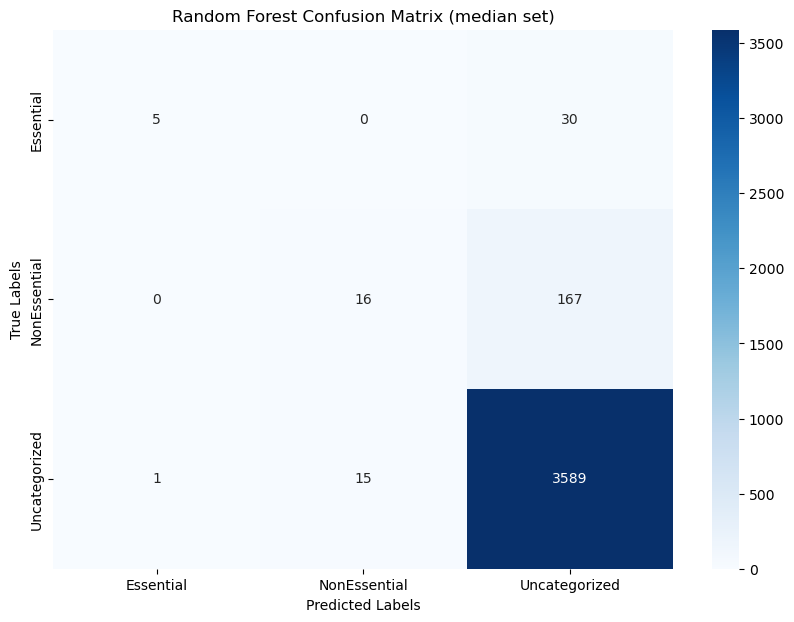

Testing std


Results for std set:
Accuracy: 0.9429767198535182
F1 Score: 0.925638885718169
              precision    recall  f1-score   support

          -1       0.95      0.99      0.97      3605
           0       0.47      0.10      0.16       183
           1       0.58      0.20      0.30        35

    accuracy                           0.94      3823
   macro avg       0.67      0.43      0.48      3823
weighted avg       0.92      0.94      0.93      3823



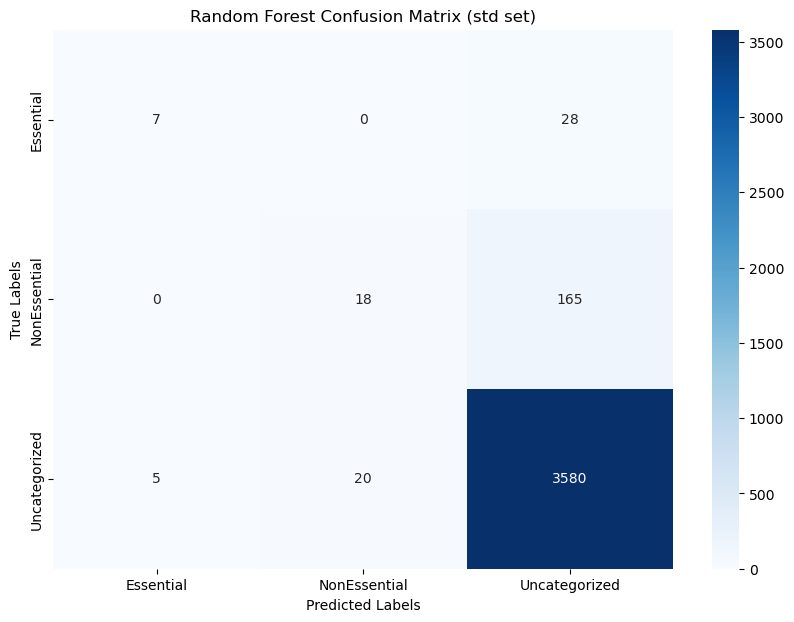

In [28]:
# Iterate through the named tuples
for set_name in train_sets._fields:
    print(f"Testing {set_name}")
    # Get the corresponding train and test sets
    X_train_set = getattr(train_sets, set_name)
    X_test_set = getattr(test_sets, set_name)
    
    # Initialize the RandomForestClassifier
    rf_model = RandomForestClassifier(n_estimators=300, random_state=1338)
    
    # Fit the model
    rf_model.fit(X_train_set, y_train)
    
    # Predict the test set
    y_pred = rf_model.predict(X_test_set)
    
    #print features importances
    feat=rf_model.feature_importances_

    # Create a DataFrame to display the feature importances
    feature_importances_df = pd.DataFrame({
        'Feature': X_train_set.columns,
        'Importance': feat
    }).sort_values(by='Importance', ascending=False)

    # Display the feature importances
    show(feature_importances_df)   
    # Calculate accuracy and F1 score
    accuracy = metrics.accuracy_score(y_test, y_pred)
    f1_score = metrics.f1_score(y_test, y_pred, average='weighted')
    
    # Print the results
    print(f"Results for {set_name} set:")
    print(f"Accuracy: {accuracy}")
    print(f"F1 Score: {f1_score}")
    print(metrics.classification_report(y_test, y_pred))
    
    # Create and display the confusion matrix
    fig = create_plot_confusion_matrix(y_test, y_pred, f'Random Forest Confusion Matrix ({set_name} set)')
    plt.show()

# Observation

All three still perform pretty poorly. But, the mean is slightyly better. The relative feature importances are the same though, with expression having the biggest impact. Will try hyperparameter tuning on X_train_mean.


In [68]:
# parameter testing
#param_grid = {'n_estimators': np.arange(10,200,10), 'criterion': ['gini', 'entropy', 'log_loss'], 'max_depth': np.arange(3,20)}
#rf=RandomForestClassifier(random_state=1338)
#rf_cv=GridSearchCV(rf, param_grid, cv=5)
#rf_cv.fit(X_train_mean, y_train)
#print("Best Score:" + str(rf_cv.best_estimator_))
#print("Best Score:" + str(rf_cv.best_score_))
#print("Best params: " + str(rf_cv.best_params_))


# Notes on GridSearch

This took 483m 38.4s to run

Best Score:RandomForestClassifier(criterion='entropy', max_depth=11, n_estimators=190,
                       random_state=1338)

Best Score:0.9470311046476201

Best params: {'criterion': 'entropy', 'max_depth': 11, 'n_estimators': 190}

Noting this so I can comment out code to not have to rerun if I rerun the notebook.

Results for std set:
Accuracy: 0.9442845932513733
F1 Score: 0.9224850504595878
              precision    recall  f1-score   support

          -1       0.95      1.00      0.97      3605
           0       0.47      0.04      0.07       183
           1       0.80      0.23      0.36        35

    accuracy                           0.94      3823
   macro avg       0.74      0.42      0.47      3823
weighted avg       0.92      0.94      0.92      3823



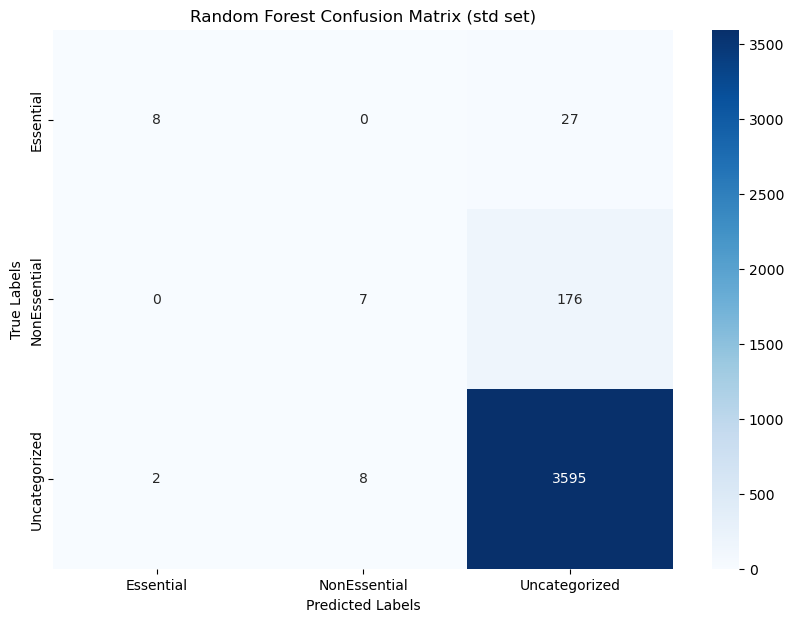

In [29]:
# Train and test model using GridSearch parameters

# Initialize the RandomForestClassifier
rf_model = RandomForestClassifier(n_estimators=190, criterion='entropy', max_depth=11, random_state=1338)
    
# Fit the model
rf_model.fit(X_train_mean, y_train)
    
# Predict the test set
y_pred = rf_model.predict(X_test_mean)
    
#print features importances
feat=rf_model.feature_importances_

# Create a DataFrame to display the feature importances
feature_importances_df = pd.DataFrame({
    'Feature': X_train_set.columns,
    'Importance': feat
}).sort_values(by='Importance', ascending=False)

# Display the feature importances
show(feature_importances_df)   
# Calculate accuracy and F1 score
accuracy = metrics.accuracy_score(y_test, y_pred)
f1_score = metrics.f1_score(y_test, y_pred, average='weighted')
    
# Print the results
print(f"Results for {set_name} set:")
print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1_score}")
print(metrics.classification_report(y_test, y_pred))
    
# Create and display the confusion matrix
fig = create_plot_confusion_matrix(y_test, y_pred, f'Random Forest Confusion Matrix ({set_name} set)')
plt.show()

# Observations

This is still a crappy model. Most things (essential and non-essential are getting categorized as 'Uncategorized'). This further supports my notion that there are likely essential and non-essential genes in the 'Uncategorized' set. 

# XGBoost

Will try full dataset on XGBoost model. 

Using: https://www.kaggle.com/code/emmanuelfwerr/xgboost-multi-class-classification as a guide


              precision    recall  f1-score   support

          -1       0.95      1.00      0.97      3605
           0       0.47      0.04      0.07       183
           1       0.80      0.23      0.36        35

    accuracy                           0.94      3823
   macro avg       0.74      0.42      0.47      3823
weighted avg       0.92      0.94      0.92      3823

Confusion Matrix:


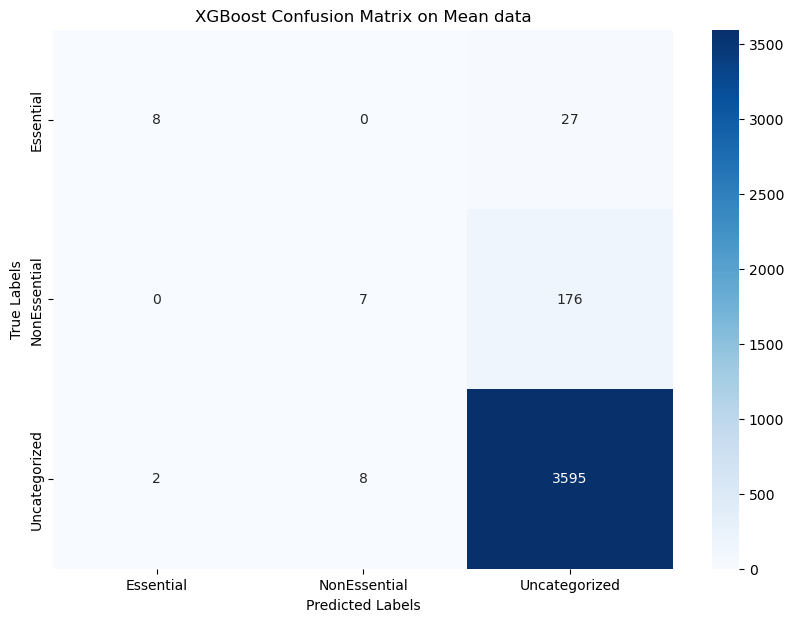

In [30]:
# Run with default hyper parameters

# XGBoost is expecting consecutive integers for the labels, so I need to map -1, 0, 1 to 0,1,2
label_mapping={-1: 2, 0: 0, 1:1}
y_train_mapped = y_train.map(label_mapping)
y_test_mapped = y_test.map(label_mapping)

xgb_clf = xgb.XGBClassifier(objective='multi:softmax',
                            num_class=3,
                            missing=1,
                            early_stopping_rounds=10,
                            eval_metric=['merror', 'mlogloss'], 
                            seed=42)
xgb_clf.fit(X_train_mean, y_train_mapped, verbose=0, eval_set=[(X_train_mean, y_train_mapped), (X_test_mean, y_test_mapped)])


## ---------- Model Classification Report ----------
## get predictions and create model quality report

y_pred_mapped = xgb_clf.predict(X_test_mean)

# Evaluate the model
print(classification_report(y_test, y_pred))

# Calculate the confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Print the confusion matrix
print("Confusion Matrix:")
# Create and display the confusion matrix
fig = create_plot_confusion_matrix(y_test, y_pred, f'XGBoost Confusion Matrix on Mean data')
plt.show()

# Observation

This looks as bad as the Random Forest!

# Conclusion

The uncategorized data is causing too much confusion in the model building. What happens if we try to remove this data and just train on the 'essential' and 'Nonessential' labels?

# Binary classification

1. Remove Uncategorized genes
2. Go ahead and get rid of correlated, redundant columns
2. Repeat process from above

In [31]:
print(full_df.shape)
# Drop rows where 'Annotation' is 'Uncategorized'
mini_df = full_df[full_df['Annotation'] != -1]
mini_df = mini_df.drop(columns=columns_to_drop)

print(mini_df.shape)
# Display the updated dataframe
show(mini_df)

(19115, 23)
(1065, 14)


In [32]:
X_mini = mini_df.drop(columns=['Annotation', 'Target Gene ID'])
y_mini = mini_df['Annotation']
show(X_mini.head())
show(y_mini.head())

In [33]:
# test, train splits
X_mini_train, X_mini_test, y_mini_train, y_mini_test = train_test_split(X_mini, y_mini, test_size=0.2, random_state=42)

print(f"X train: {X_mini_train.shape}")
print(f"X test: {X_mini_test.shape}")

print(f"Annotation mini: {mini_df['Annotation'].value_counts()} {mini_df['Annotation'].value_counts(normalize=True) * 100}%")
print(f"Annotation split (train): {y_mini_train.value_counts()} {y_mini_train.value_counts(normalize=True) * 100}%")
print(f"Annotation split (test) {y_mini_test.value_counts()} {y_mini_test.value_counts(normalize=True) * 100}%")

X train: (852, 12)
X test: (213, 12)
Annotation mini: Annotation
0    858
1    207
Name: count, dtype: int64 Annotation
0    80.56338
1    19.43662
Name: proportion, dtype: float64%
Annotation split (train): Annotation
0    686
1    166
Name: count, dtype: int64 Annotation
0    80.516432
1    19.483568
Name: proportion, dtype: float64%
Annotation split (test) Annotation
0    172
1     41
Name: count, dtype: int64 Annotation
0    80.751174
1    19.248826
Name: proportion, dtype: float64%


In [34]:
X_mini_train_mean=X_mini_train.drop(columns=non_mean_cols)
X_mini_test_mean=X_mini_test.drop(columns=non_mean_cols)
X_mini_train_med=X_mini_train.drop(columns=non_med_cols)
X_mini_test_med=X_mini_test.drop(columns=non_med_cols)
X_mini_train_std=X_mini_train.drop(columns=non_std_cols)
X_mini_test_std=X_mini_test.drop(columns=non_std_cols)
show(X_mini_train_mean.head())
show(X_mini_train_med.head())
show(X_mini_train_std.head())
print(X_mini_train_mean.shape)
print(X_mini_test_mean.shape)
print(X_mini_train_med.shape)
print(X_mini_test_med.shape)
print(X_mini_train_std.shape)
print(X_mini_test_std.shape)
print(y_mini_train.shape)
print(y_mini_test.shape)

(852, 8)
(213, 8)
(852, 8)
(213, 8)
(852, 8)
(213, 8)
(852,)
(213,)


In [35]:
# will make named tuples in case I want to cycle again, but may do some quick tests with mean

# Instantiate the named tuple with the three dataframes
mini_train_sets = DataFrameSet(mean=X_mini_train_mean, median=X_mini_train_med, std=X_mini_train_std)
mini_test_sets = DataFrameSet(mean=X_mini_test_mean, median=X_mini_test_med, std=X_mini_test_std)

# Decision Tree

## Mean, mini set

In [36]:
print(X_mini_train_mean.shape)
print(y_mini_train.shape)

(852, 8)
(852,)


In [37]:
# entropy model
entr_nonopt_model=tree.DecisionTreeClassifier(criterion='entropy', random_state=1338)
#fit model
entr_nonopt_model.fit(X_mini_train_mean, y_mini_train)
#predict
entr_nonopt_y_pred = entr_nonopt_model.predict(X_mini_test_mean)
#turn into a series
entr_nonopt_y_pred = pd.Series(entr_nonopt_y_pred)

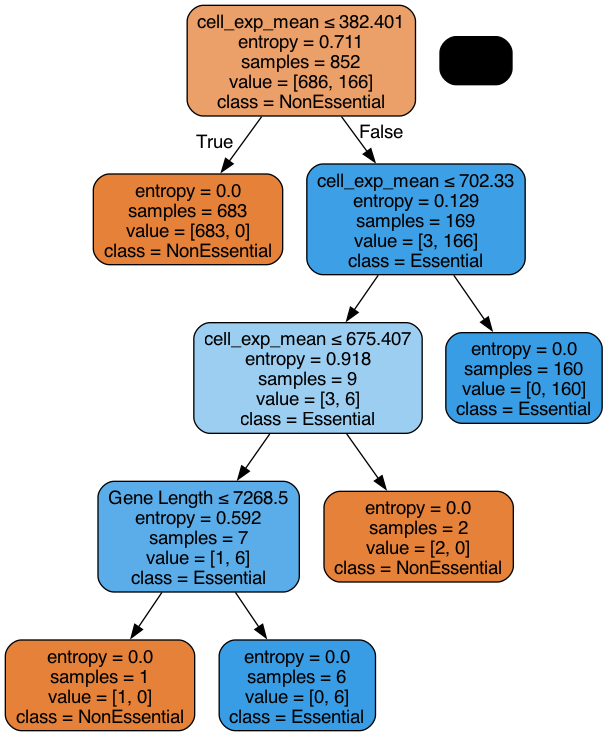

In [38]:
# Visualize Tree
dot_data = StringIO()

tree.export_graphviz(entr_nonopt_model, out_file=dot_data,
                     filled=True, rounded=True,
                     special_characters=True, feature_names=X_mini_train_mean.columns, class_names=['NonEssential', 'Essential'])
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

Model Entropy - no max depth
Accuracy: 0.9906103286384976
Balanced accuracy: 0.9941860465116279


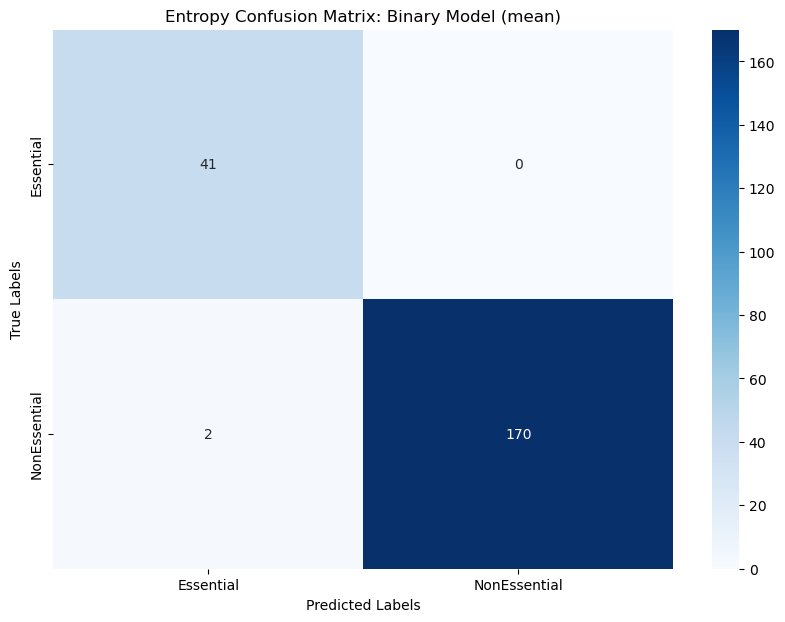

In [39]:
# Run this block for model evaluation metrics 
print("Model Entropy - no max depth")
print("Accuracy:", metrics.accuracy_score(y_mini_test, entr_nonopt_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_mini_test, entr_nonopt_y_pred))

 # Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential'}

# Map the numerical values to string labels
y_test_mapped = y_mini_test.map(label_mapping)
y_pred_mapped = pd.Series(entr_nonopt_y_pred).map(label_mapping)

# Calculate the confusion matrix
conf_matrix = metrics.confusion_matrix(y_test_mapped, y_pred_mapped)

# Get the unique class labels
class_labels = ['Essential', 'NonEssential']

# Plot the confusion matrix
fig = plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title("Entropy Confusion Matrix: Binary Model (mean)")

plt.show()

# Conclusion

OK- the simple, non-optimized decision tree does a pretty good job once you remove the 'Uncategorized' data. This supports my concern that the 'Uncategorized' data has both 'essential' and 'nonessential' genes, and this is confusing the classification model. 

# Next step
Optimize a bit more and try on a couple of additional datasets. 

In [40]:
# gini model
gini_nonopt_model=tree.DecisionTreeClassifier(criterion='gini', random_state=1338)
#fit model
gini_nonopt_model.fit(X_mini_train_mean, y_mini_train)
#predict
gini_nonopt_y_pred = gini_nonopt_model.predict(X_mini_test_mean)
#turn into a series
gini_nonopt_y_pred = pd.Series(gini_nonopt_y_pred)

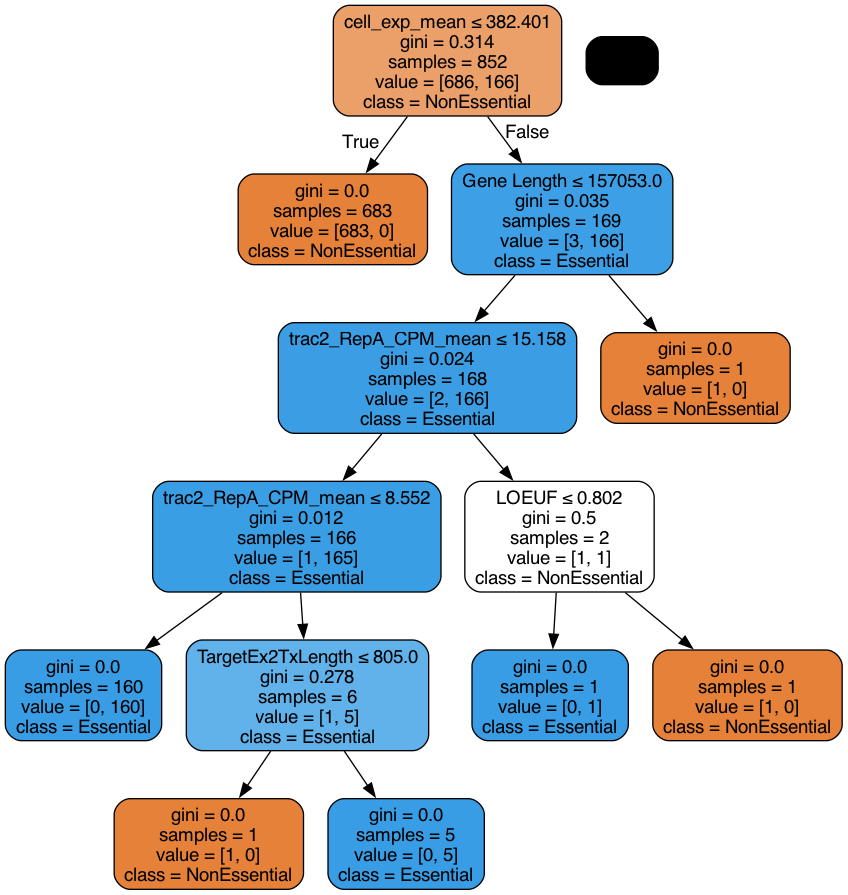

In [41]:
# Visualize Tree
dot_data = StringIO()

tree.export_graphviz(gini_nonopt_model, out_file=dot_data,
                     filled=True, rounded=True,
                     special_characters=True, feature_names=X_mini_train_mean.columns, class_names=['NonEssential', 'Essential'])
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

Model Gini - no max depth
Accuracy: 0.9906103286384976
Balanced accuracy: 0.975609756097561


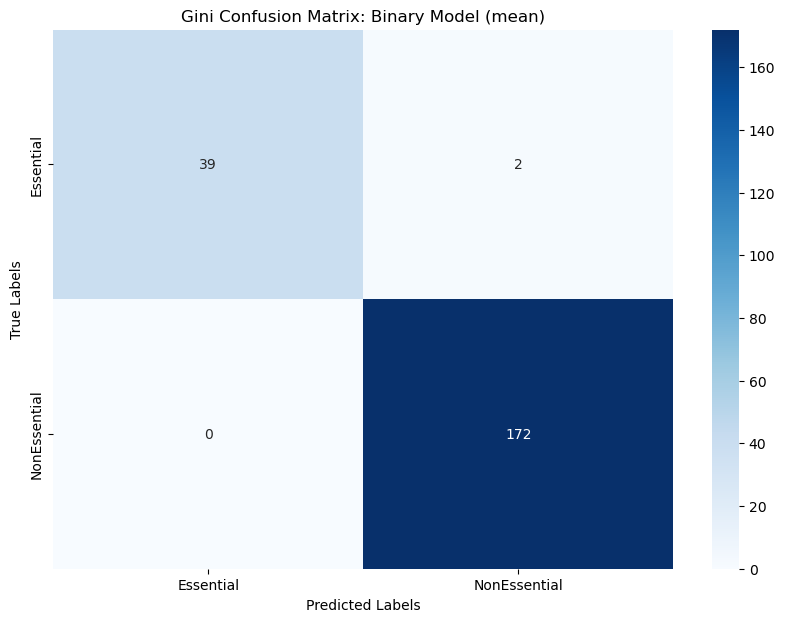

In [42]:
# Run this block for model evaluation metrics 
print("Model Gini - no max depth")
print("Accuracy:", metrics.accuracy_score(y_mini_test, gini_nonopt_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_mini_test, gini_nonopt_y_pred))

 # Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential'}

# Map the numerical values to string labels
y_test_mapped = y_mini_test.map(label_mapping)
y_pred_mapped = pd.Series(gini_nonopt_y_pred).map(label_mapping)

# Calculate the confusion matrix
conf_matrix = metrics.confusion_matrix(y_test_mapped, y_pred_mapped)

# Get the unique class labels
class_labels = ['Essential', 'NonEssential']

# Plot the confusion matrix
fig = plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title("Gini Confusion Matrix: Binary Model (mean)")

plt.show()

# Conclusion

Using entropy predicted all essential genes correctly, and misclassified 2 non-essential genes. Using gini flipped that. 

Will try to hyperparameter tuning on a decision tree before moving to Random Forest


In [45]:
# parameter testing for Decision tree
param_grid = {'max_depth': [2, 4, 6, None], 'criterion': ['gini', 'entropy', 'log_loss'], 'min_samples_split': [5,10,15], 'max_features': [2,3,4,5,6]}
dtree=tree.DecisionTreeClassifier(random_state=1338)
dtree_cv=GridSearchCV(dtree, param_grid, cv=5)
dtree_cv.fit(X_mini_train_mean, y_mini_train)
print("Best Score:" + str(dtree_cv.best_estimator_))
print("Best Score:" + str(dtree_cv.best_score_))
print("Best params: " + str(dtree_cv.best_params_))

Best Score:DecisionTreeClassifier(max_depth=2, max_features=3, min_samples_split=5,
                       random_state=1338)
Best Score:0.9976539387684898
Best params: {'criterion': 'gini', 'max_depth': 2, 'max_features': 3, 'min_samples_split': 5}


In [46]:
# Optimized Decision Tree
dtree_model=tree.DecisionTreeClassifier(criterion='gini', max_depth=2, max_features=3, min_samples_split=5, random_state=1338)
#fit model
dtree_model.fit(X_mini_train_mean, y_mini_train)
#predict
dtree_y_pred = dtree_model.predict(X_mini_test_mean)
#turn into a series
dtree_y_pred = pd.Series(dtree_y_pred)

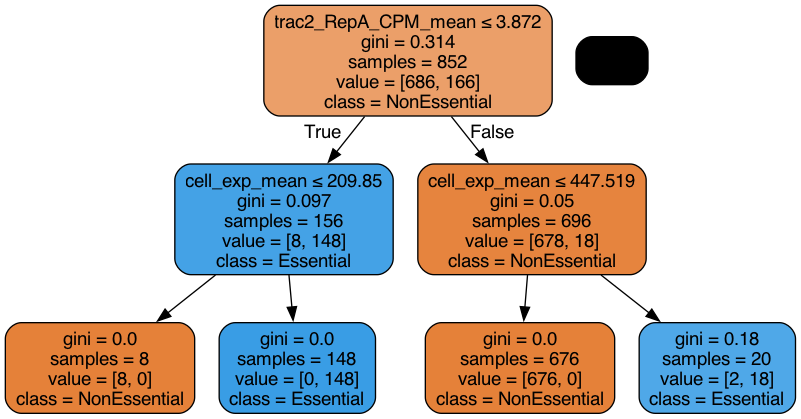

In [47]:
# Visualize Tree
dot_data = StringIO()

tree.export_graphviz(dtree_model, out_file=dot_data,
                     filled=True, rounded=True,
                     special_characters=True, feature_names=X_mini_train_mean.columns, class_names=['NonEssential', 'Essential'])
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

Tuned Decision Tree Model
Accuracy: 0.9906103286384976
Balanced accuracy: 0.9941860465116279


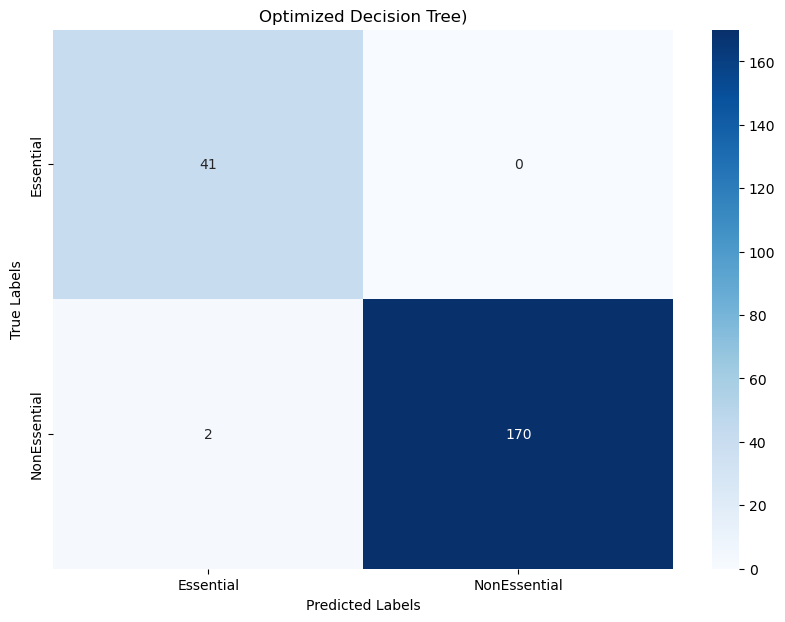

In [48]:
# Run this block for model evaluation metrics 
print("Tuned Decision Tree Model")
print("Accuracy:", metrics.accuracy_score(y_mini_test, dtree_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_mini_test, dtree_y_pred))

 # Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential'}

# Map the numerical values to string labels
y_test_mapped = y_mini_test.map(label_mapping)
y_pred_mapped = pd.Series(dtree_y_pred).map(label_mapping)

# Calculate the confusion matrix
conf_matrix = metrics.confusion_matrix(y_test_mapped, y_pred_mapped)

# Get the unique class labels
class_labels = ['Essential', 'NonEssential']

# Plot the confusion matrix
fig = plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title("Optimized Decision Tree)")

plt.show()

In [71]:
final_feature_importances=dtree_model.feature_importances_

# Create a DataFrame to display the feature importances
feature_importances_df = pd.DataFrame({
    'Feature': X_mini_train_mean.columns,
    'Importance': final_feature_importances
}).sort_values(by='Importance', ascending=False)

# Display the feature importances
print(feature_importances_df)

               Feature  Importance
0  trac2_RepA_CPM_mean     0.82311
5        cell_exp_mean     0.17689
1      Target Exon_min     0.00000
2            Tx Length     0.00000
3   Gene Isoform Count     0.00000
4          Gene Length     0.00000
6                LOEUF     0.00000
7    TargetEx2TxLength     0.00000


# Feature importance

There are only two features driving this model, guide counts (majority) and expression. 

# Try Trac1 on model

In [49]:
trac1_df=pd.read_csv('../data/processed/brunello_trac1_gene_level_data.csv')
show(trac1_df)

In [50]:
trac1_df=calculate_ratio(trac1_df, 'Tx Length', 'Target Exon_min', 'TargetEx2TxLength')
# Rename columns
trac1_df.rename(columns={'A375 mean': 'cell_exp_mean', 'A375 median': 'cell_exp_median', 'A375 std_dev': 'cell_exp_std_dev'}, inplace=True)

# Display the updated dataframe
show(trac1_df.head())

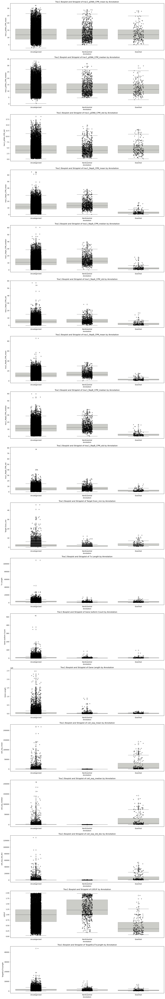

In [53]:
# List of numerical columns excluding 'Target Gene ID'
numerical_columns = trac1_df.select_dtypes(include=[np.number]).columns.tolist()
numerical_columns.remove('Target Gene ID')

# Set up the figure
fig, axes = plt.subplots(len(numerical_columns), 1, figsize=(15, 5 * len(numerical_columns)))

# Plot each numerical column
for i, col in enumerate(numerical_columns):
    sns.boxplot(x='Annotation', y=col, data=trac1_df, ax=axes[i], color="#9B9B93", boxprops=dict(alpha=0.5))
    sns.stripplot(x='Annotation', y=col, data=trac1_df, ax=axes[i], color='black', alpha=0.5, jitter=True)
    axes[i].set_title(f'Trac1 Boxplot and Stripplot of {col} by Annotation')

plt.tight_layout()
plt.show()

In [54]:
# Convert 'Annotation' column to numerical values
annotation_mapping = {'Uncategorized': -1, 'NonEssential': 0, 'Essential': 1}
trac1_df['Annotation'] = trac1_df['Annotation'].map(annotation_mapping)

# Display the updated dataframe
show(trac1_df)

In [56]:
#just noticed I need to correct the NaN in TargetEx2TxLenth
trac1_df['TargetEx2TxLength']=trac1_df['TargetEx2TxLength'].fillna(0)
trac1_df['trac1_pDNA_CPM_std']=trac1_df['trac1_pDNA_CPM_std'].fillna(0)
trac1_df['trac1_RepA_CPM_std']=trac1_df['trac1_RepA_CPM_std'].fillna(0)
trac1_df['trac1_RepB_CPM_std']=trac1_df['trac1_RepB_CPM_std'].fillna(0)
trac1_df.isna().sum()

Target Gene ID           0
trac1_pDNA_CPM_mean      0
trac1_pDNA_CPM_median    0
trac1_pDNA_CPM_std       0
trac1_RepA_CPM_mean      0
trac1_RepA_CPM_median    0
trac1_RepA_CPM_std       0
trac1_RepB_CPM_mean      0
trac1_RepB_CPM_median    0
trac1_RepB_CPM_std       0
Target Exon_min          0
Tx Length                0
Gene Isoform Count       0
Gene Length              0
cell_exp_mean            0
cell_exp_median          0
cell_exp_std_dev         0
LOEUF                    0
Annotation               0
TargetEx2TxLength        0
dtype: int64

In [60]:
# Drop columns starting with 'trac2_pDNA', 'trac2_RepB', and 'trac2_RepC'
columns_to_drop = trac1_df.filter(regex='^(trac1_pDNA|trac1_RepB)').columns
trac1_repA_df=trac1_df.drop(columns=columns_to_drop)
show(trac1_repA_df)

In [61]:
# Drop rows where 'Annotation' is 'Uncategorized'
mini_trac1_df = trac1_repA_df[trac1_repA_df['Annotation'] != -1]
show(mini_trac1_df)

In [62]:
mini_trac1_df=mini_trac1_df.drop(columns=['trac1_RepA_CPM_median', 'trac1_RepA_CPM_std'])
show(mini_trac1_df)

In [67]:
X_mini_trac1_df=mini_trac1_df.drop(columns=['Target Gene ID', 'Annotation', 'cell_exp_median', 'cell_exp_std_dev'])
y_mini_trac1_df=mini_trac1_df['Annotation']
show(X_mini_trac1_df.head())
show(y_mini_trac1_df.head())

In [68]:
# Need to be more robust- but for now will change 'trac1_RepA_CPM_mean' to 'trac2_RepA_CPM_mean' so model will work. 
X_mini_trac1_df=X_mini_trac1_df.rename(columns={'trac1_RepA_CPM_mean': 'trac2_RepA_CPM_mean'})

In [69]:
#predict
dtree_trac1_y_pred = dtree_model.predict(X_mini_trac1_df)
#turn into a series
dtree_trac1_y_pred = pd.Series(dtree_trac1_y_pred)

Tuned Decision Tree Model on New Data
Accuracy: 0.9953051643192489
Balanced accuracy: 0.9952535387317996


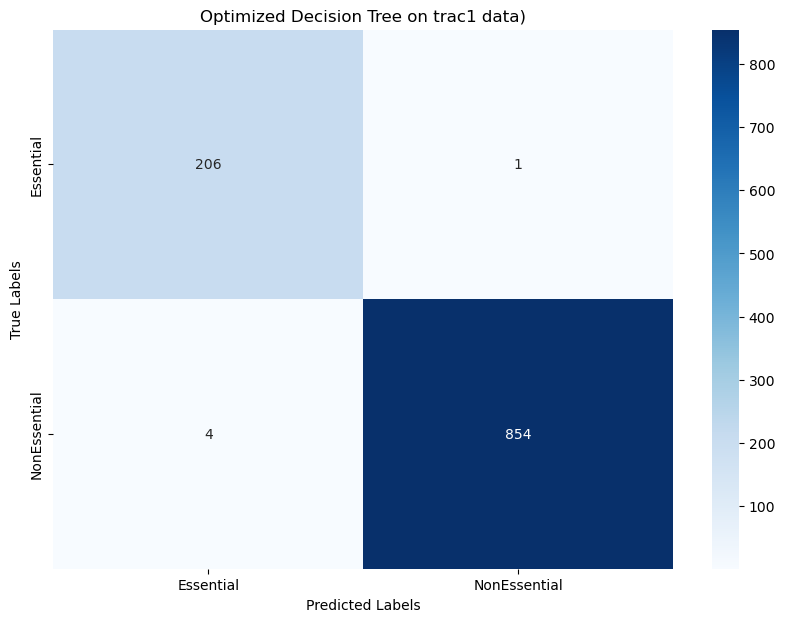

In [70]:
# Run this block for model evaluation metrics 
print("Tuned Decision Tree Model on New Data")
print("Accuracy:", metrics.accuracy_score(y_mini_trac1_df, dtree_trac1_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_mini_trac1_df, dtree_trac1_y_pred))

 # Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential'}

# Map the numerical values to string labels
y_test_mapped = y_mini_trac1_df.map(label_mapping)
y_pred_mapped = pd.Series(dtree_trac1_y_pred).map(label_mapping)

# Calculate the confusion matrix
conf_matrix = metrics.confusion_matrix(y_test_mapped, y_pred_mapped)

# Get the unique class labels
class_labels = ['Essential', 'NonEssential']

# Plot the confusion matrix
fig = plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title("Optimized Decision Tree on trac1 data)")

plt.show()

# Conclusion

Model generalizes pretty well on a different data set using the same cell line expression. 